# Computer Vision 2023 Assignment 1: Image filtering.

In this prac you will research, implement and test some image filtering operations. Image filtering by convolution is a fundamental step in many computer vision tasks and you will find it useful to have a firm grasp of how it works. For example, later in the course we will come across Convolutional Neural Networks (CNNs) which are built from convolutional image filters.

The main aims of the prac are:

- to understand the basics of how images are stored and processed in memory;
- to gain exposure to several common image filters, and understand how they work;
- to get practical experience implementing convolutional image filters;
- to test your intuition about image filtering by running some experiments;
- to report your results in a clear and concise manner.

*This assignment relates to the following ACS CBOK areas: abstraction, design, hardware and software, data and information, HCI and programming.*

## General instructions

Follow the instructions in this Python notebook and the accompanying file *a1code.py* to answer each question. It's your responsibility to make sure your answer to each question is clearly labelled and easy to understand. Note that most questions require some combination of Python code, graphical output, and text analysing or describing your results. Although we will check your code as needed, marks will be assigned based on the quality of your write up rather than for code correctness! This is not a programming test - we are more interested in your understanding of the topic.

Only a small amount of code is required to answer each question. We will make extensive use of the Python libraries

- [numpy](numpy.org) for mathematical functions
- [skimage](https://scikit-image.org) for image loading and processing
- [matplotlib](https://matplotlib.org/stable/index.html) for displaying graphical results
- [jupyter](https://jupyter.org) for Jupyter Notebooks

You should get familiar with the documentation for these libraries so that you can use them effectively.

# The Questions

To get started, below is some setup code to import the libraries we need. You should not need to edit it.

In [1]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np

#from skimage import io

# Imports all the methods we define in the file a1code.py
from a1code import *

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

## Question 0: Numpy warm up! (5%)

Before starting the assignment, make sure you have a working Python 3 installation, with up to date versions of the libraries mentioned above. If this is all new to you, I'd suggest  downloading an all in one Python installation such as [Anaconda](https://www.anaconda.com/products/individual). Alternatively you can use a Python package manager such as pip or conda, to get the libraries you need. If you're struggling with this please ask a question on the MyUni discussion forum.

For this assignment, you need some familiarity with numpy syntax. The numpy QuickStart should be enough to get you started:

https://numpy.org/doc/stable/user/quickstart.html

Here are a few warm up exercises to make sure you understand the basics. Answer them in the space below. Be sure to print the output of each question so we can see it!

1. Create a 1D numpy array Z with 12 elements. Fill with values 1 to 12.
2. Reshape Z into a 2D numpy array A with 3 rows and 4 columns.
3. Reshape Z into a 2D numpy array B with 4 rows and 3 columns.
4. Calculate the *matrix* product of A and B.
5. Calculate the *element wise* product of $A$ and $B^T$ (B transpose).


In [2]:
# creating a 1D numpy array
Z = np.arange(1,13)
print(f'1D numpy array: {Z}')
A = Z.reshape(3,4)
print(f'Reshaped array [3,4]:')
print(A)
B = Z.reshape(4,3)
print(f'Reshaped array [4,3]:')
print(B)
AB = np.matmul(A,B)
print(f'Product of matrix A and B:')
print(AB)
AB_tr = np.multiply(A,B.T)
print(f'element wise product of matrix A and B^T:')
print(AB_tr)

1D numpy array: [ 1  2  3  4  5  6  7  8  9 10 11 12]
Reshaped array [3,4]:
[[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]
Reshaped array [4,3]:
[[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]
Product of matrix A and B:
[[ 70  80  90]
 [158 184 210]
 [246 288 330]]
element wise product of matrix A and B^T:
[[  1   8  21  40]
 [ 10  30  56  88]
 [ 27  60  99 144]]


You need to be comfortable with numpy arrays because that is how we store images. Let's do that next!

## Question 1: Loading and displaying an image (10%)

Below is a function to display an image using the pyplot module in matplotlib. Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel. 

In [3]:
def display(img, caption=''):
    # Show image using pyplot 
    plt.figure()
    plt.imshow(img)
    plt.title(caption)
    plt.axis('off')
    plt.show()

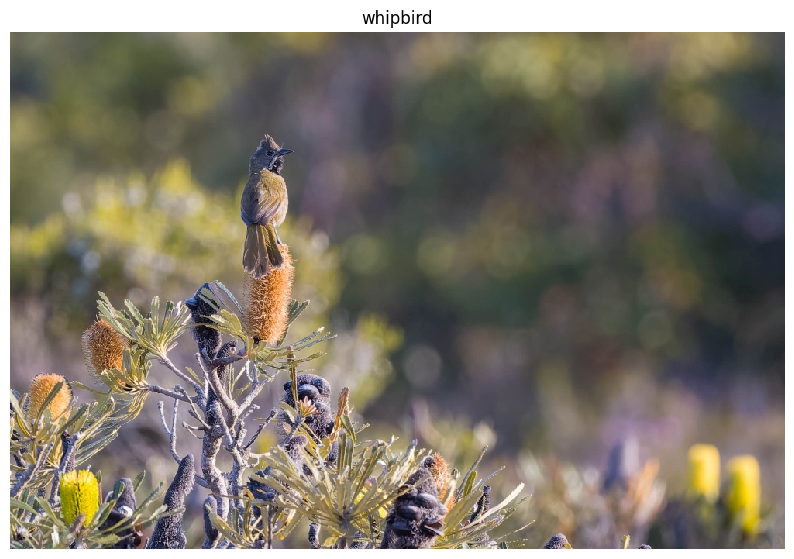

The image dimensions according to (height, width, channels) is: (667, 1000, 3)


In [4]:
image1 = load('images/whipbird.jpg')
      
display(image1, 'whipbird')

print_stats(image1)

Return to this question after reading through the rest of the assignment. Find 2 more images to use as test cases in this assignment for all the following questions and display them below. Use your print_stats() function to display their height, width and number of channels. Explain *why* you have chosen each image.

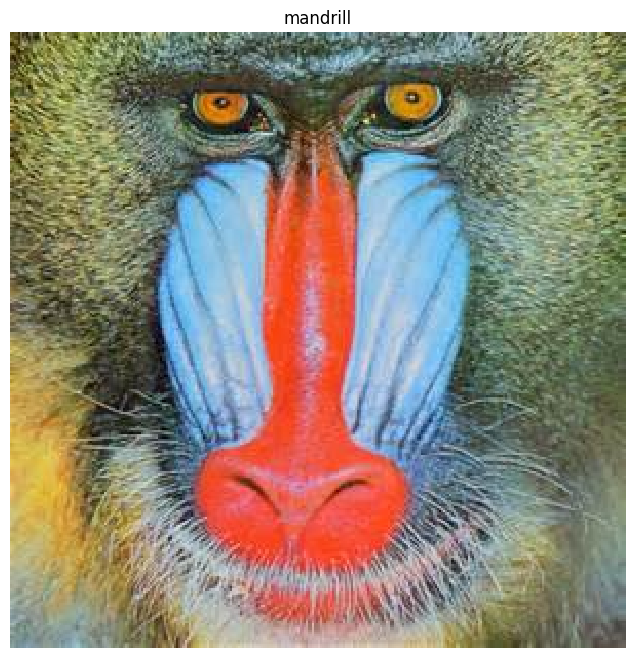

The image dimensions according to (height, width, channels) is: (300, 300, 3)


In [5]:
### Your code to load and display your images here
image2 = load('images/mandrill.jpg')   
display(image2, 'mandrill')
print_stats(image2)

#### Reason for choosing mandrill image
This is image shows various features for detection. First of all, this is a close up image and shows the hair pattern of the animal which can be considered as noise. Each strand is clearly visible and shows the directions of hairs which shows that the image is textured and will help in analyzing the effectiveness of filters in preservation of textures. It also contains vertical lines around its nose. There is a sharp edge visible around the nose section where the red color separated with the white. There are various different colours in the image that shows several bodily features of the animal.

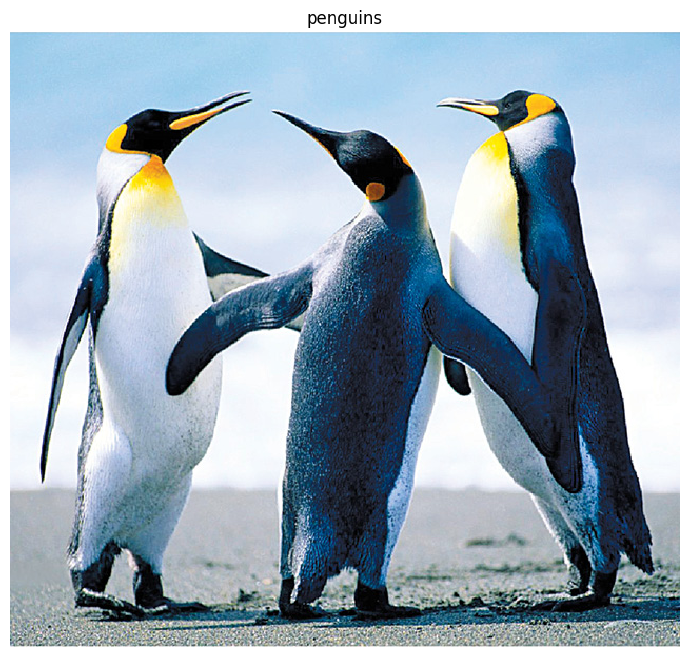

The image dimensions according to (height, width, channels) is: (585, 636, 3)


In [6]:
image3 = load('images/penguins.jpg')   
display(image3, 'penguins')
print_stats(image3)

#### Reason for choosing Penguin Image
The image is on a white background and had background blur effect already present. The image is good for representing both gaussian blur which is clearly visible in the white background and contrasting colors of penguin's body. There are definite edges both horizontal and vertical along the flaps and body of the penguins.

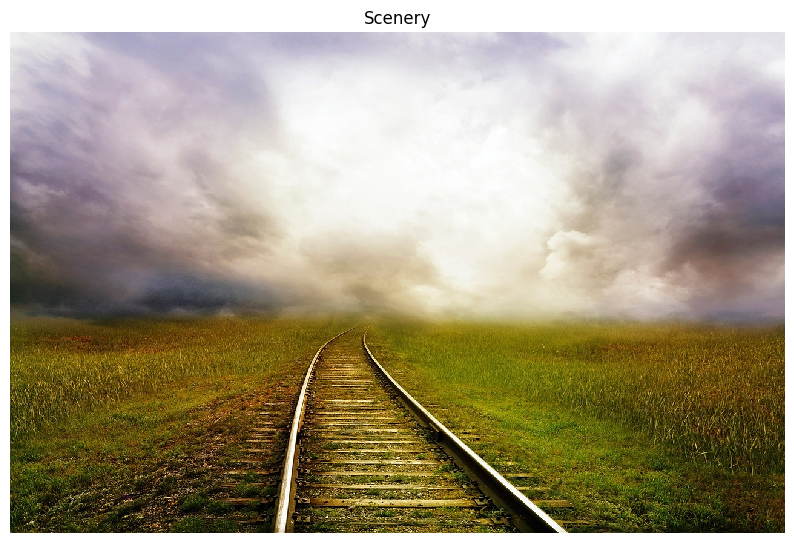

The image dimensions according to (height, width, channels) is: (827, 1280, 3)


In [7]:
image4 = load('images/testimg2.jpg')   
display(image4, 'Scenery')
print_stats(image4)

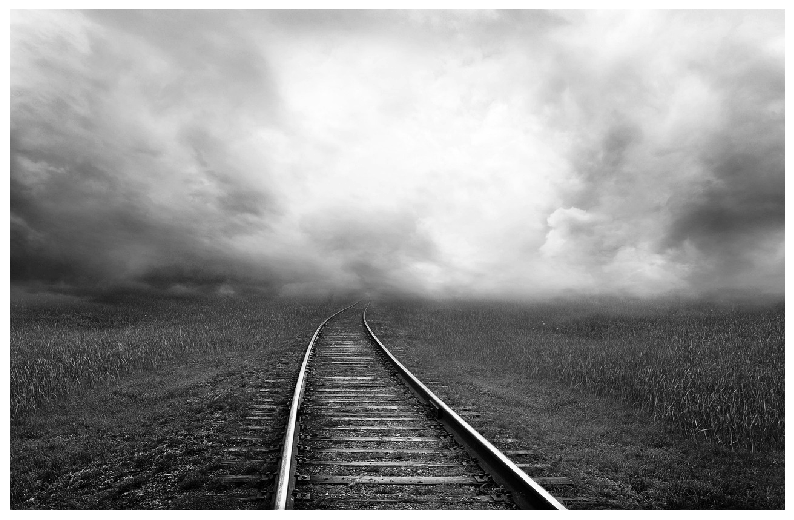

The image dimensions according to (height, width, channels) is: (827, 1280)


In [8]:
image4 = greyscale(image4)
display(image4)
print_stats(image4)

#### Reason for choosing the train tracks image
This image has a main attraction as its railway tracks. The image was imported as an RGB image which is then greyscaled with the function created in a1code. There are not much details in the neighbourhood of the railway tracks. The image contains distinct edges and gradient variation which is best for visualizing edge detection using sobel filter.

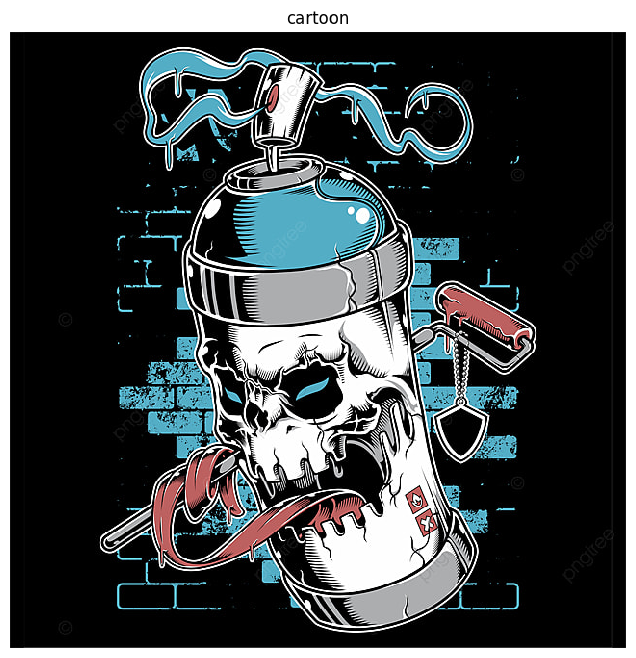

The image dimensions according to (height, width, channels) is: (640, 640, 3)


In [9]:
image5 = load('images/testimg3.jpg')   
display(image5, 'cartoon')
print_stats(image5)

#### Reason for choosing the cartoon image
This is a high contrast image on a black background. It has several edges horizontal and vertical in the form of bricks and the whole spray bottle respectively. Moreover, due to the black background and the white bottle, the gaussian blur will be clearly visible in the image.

### Point processing with the images

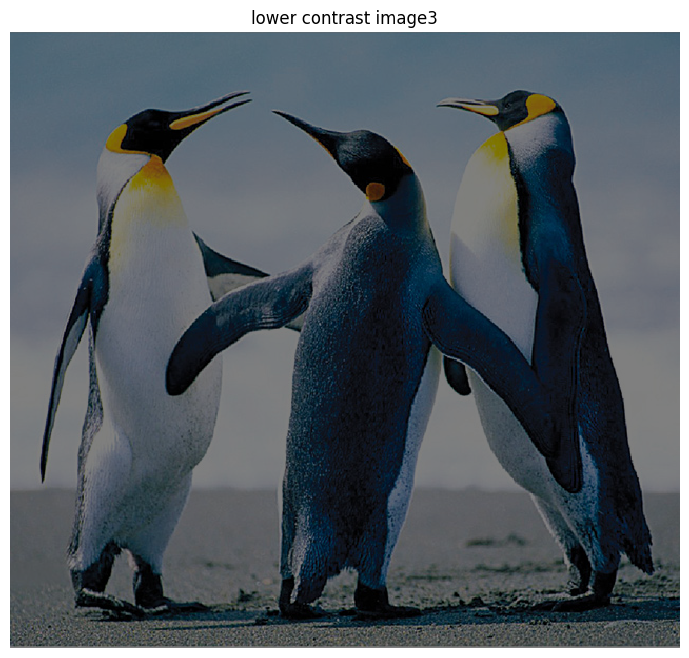

In [10]:
display(image3/2, 'lower contrast image3')
# print_stats()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


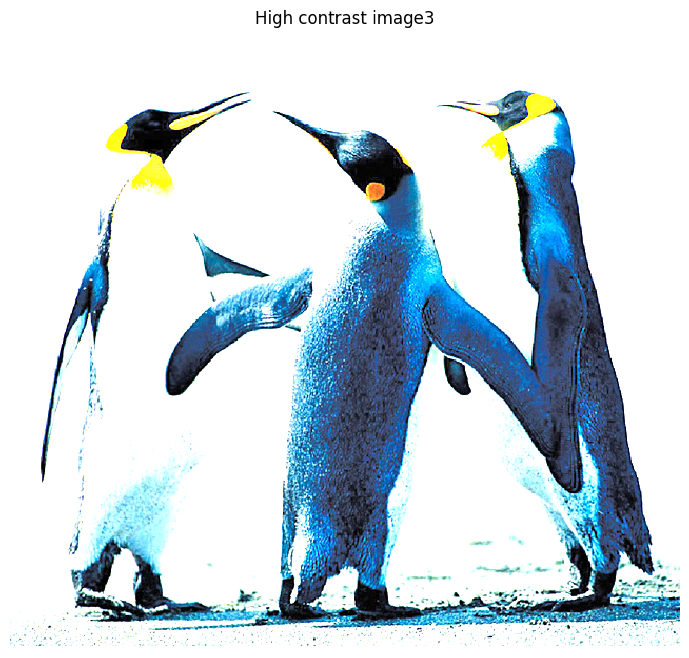

In [11]:
display(image3*2, 'High contrast image3')

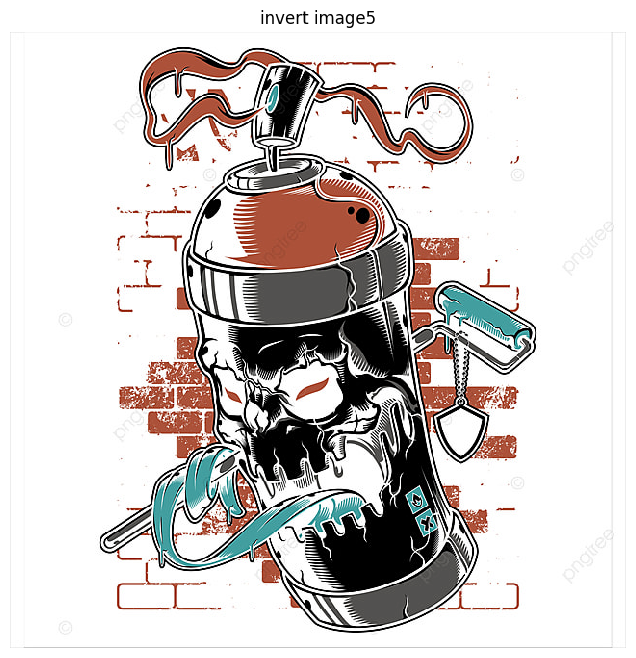

In [12]:
display(1-image5, 'invert image5')

***Your explanation of images here***
### Observation of point processing of the images
* The lower contrast added in the image of penguins decreased the whites in the image.
* The higher contrast in the image led to the pixel values going above 255 in case of integers or above 1 in case of floats. When a processed pixel value becomes < 0 or > 255, the matplotlib automatically clips the data in the desired range and gives the prompt "Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers)."
* Otherwise we can always clip the data using np.clip function
* The last image is showing the inverse of the spray bottle image where blacks converted to white and whites to blacks.

## Question 2: Image processing (25%)

Now that you have an image stored as a numpy array, let's try some operations on it.

1. Implement the `crop()` function in a1code.py. Use array slicing to crop the image.
2. Implement the `resize()` function in a1code.py.
3. Implement the `change_contrast()` function in a1code.py.
4. Implement the `greyscale()` function in a1code.py.
5. Implement the `binary()` function in a1code.py.

What do you observe when you change the threshold of the binary function?

Apply all these functions with different parameters on your own test images.

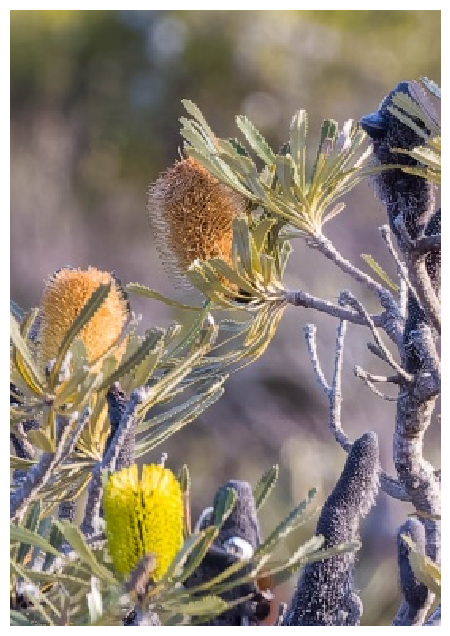

The image dimensions according to (height, width, channels) is: (389, 272, 3)


In [13]:
# This should crop the bird from the  image; you will need to adjust the parameters for the correct crop size and location 
crop_img = crop(image1, 278, 5, 508, 272)
display(crop_img) 
print_stats(crop_img)


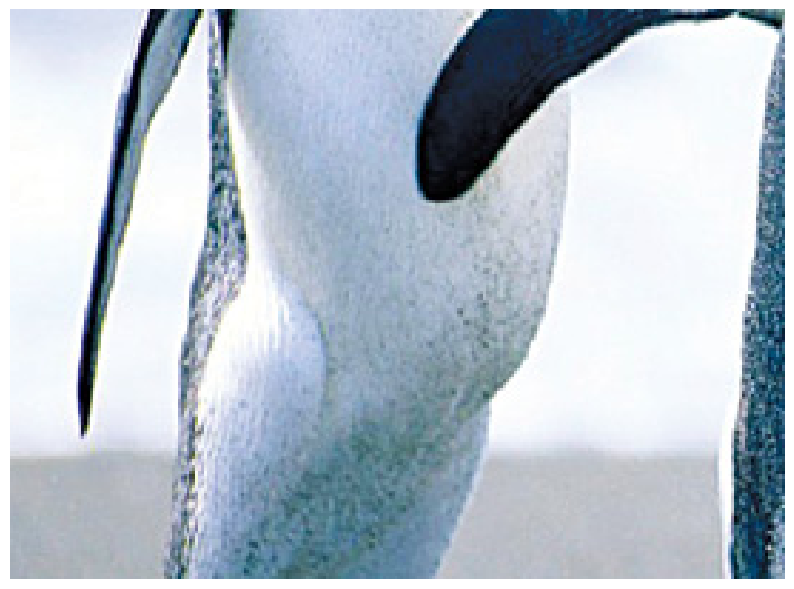

The image dimensions according to (height, width, channels) is: (200, 272, 3)


In [14]:
crop_img = crop(image3, 278, 5, 200, 272)
display(crop_img) 
print_stats(crop_img)

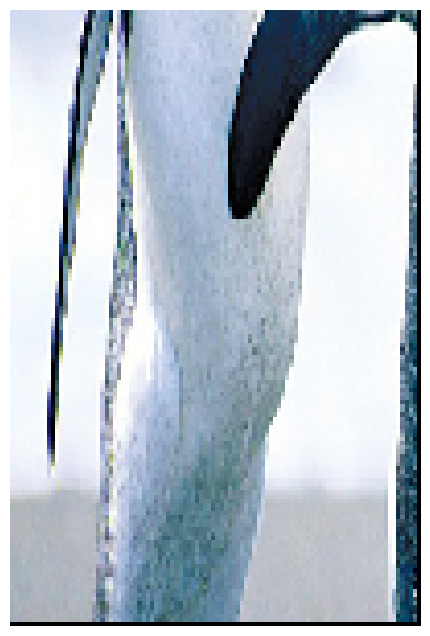

The image dimensions according to (height, width, channels) is: (150, 100, 3)


In [15]:
resize_img = resize(crop_img, 150, 100 )
display(resize_img)
print_stats(resize_img)

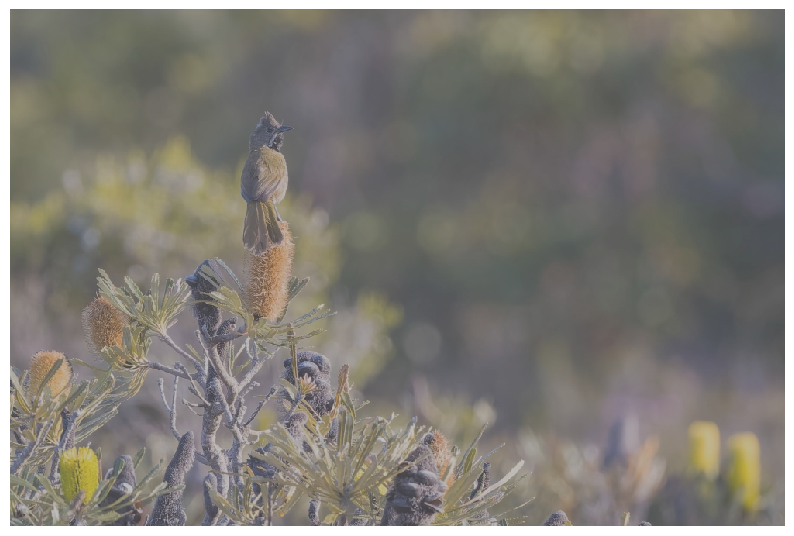

The image dimensions according to (height, width, channels) is: (667, 1000, 3)


In [16]:
contrast_img = change_contrast(image1, 0.5)
display(contrast_img)
print_stats(contrast_img)

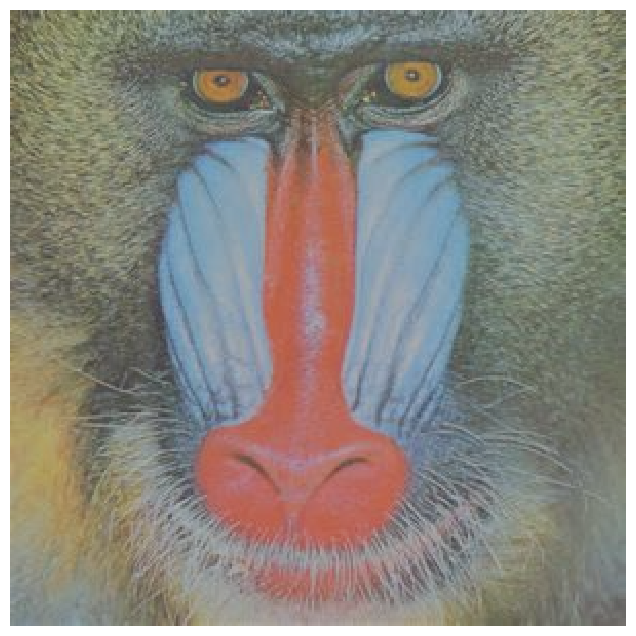

The image dimensions according to (height, width, channels) is: (300, 300, 3)


In [17]:
contrast_img = change_contrast(image2, 0.5)
display(contrast_img)
print_stats(contrast_img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


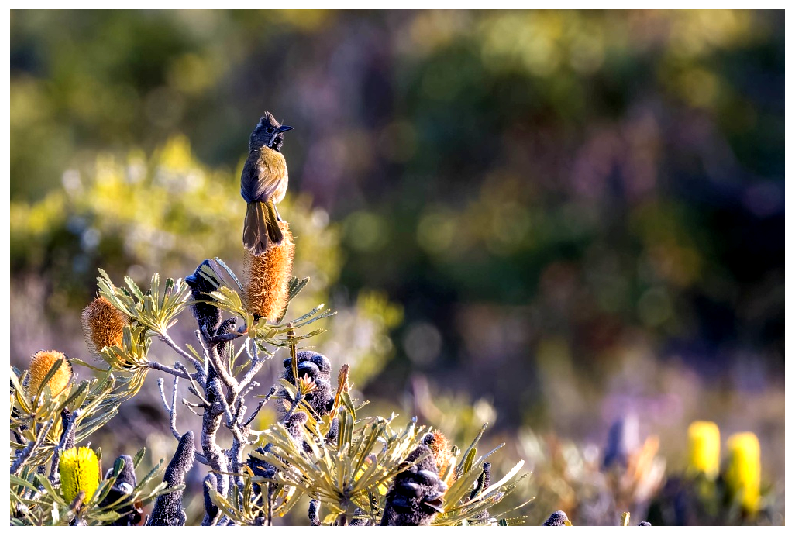

The image dimensions according to (height, width, channels) is: (667, 1000, 3)


In [18]:
contrast_img = change_contrast(image1, 1.5)
display(contrast_img)
print_stats(contrast_img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


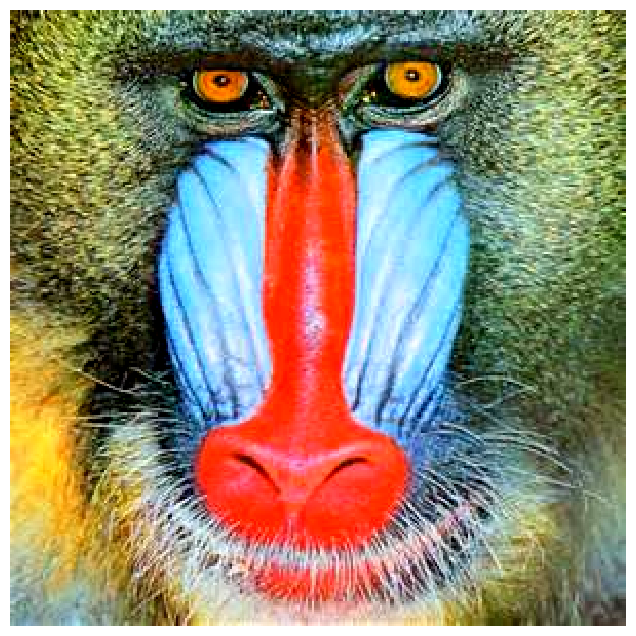

The image dimensions according to (height, width, channels) is: (300, 300, 3)


In [19]:
contrast_img = change_contrast(image2, 1.5)
display(contrast_img)
print_stats(contrast_img)

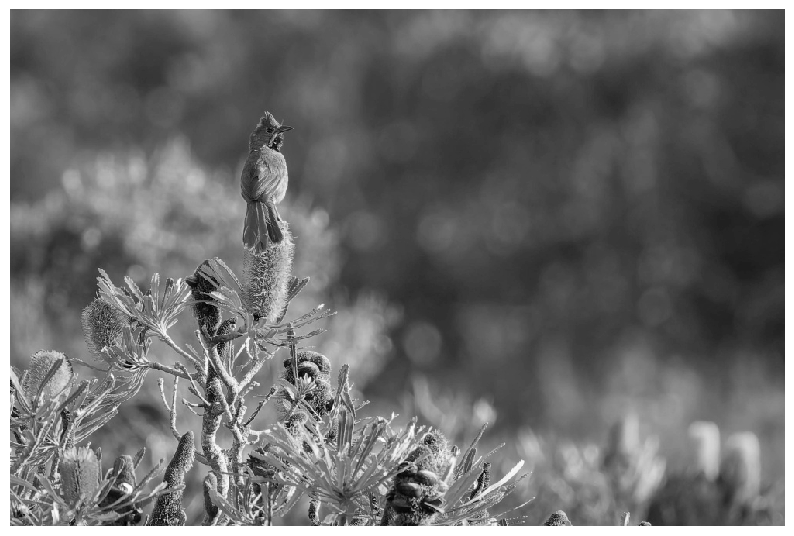

The image dimensions according to (height, width, channels) is: (667, 1000)


In [20]:
grey_img = greyscale(image1)
display(grey_img)
print_stats(grey_img)

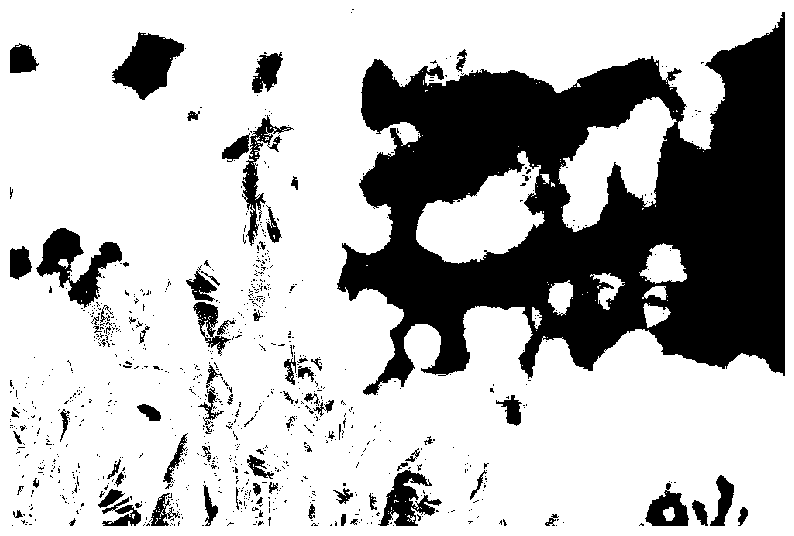

The image dimensions according to (height, width, channels) is: (667, 1000)


In [21]:
binary_img = binary(grey_img, 0.3)
display(binary_img)
print_stats(binary_img)

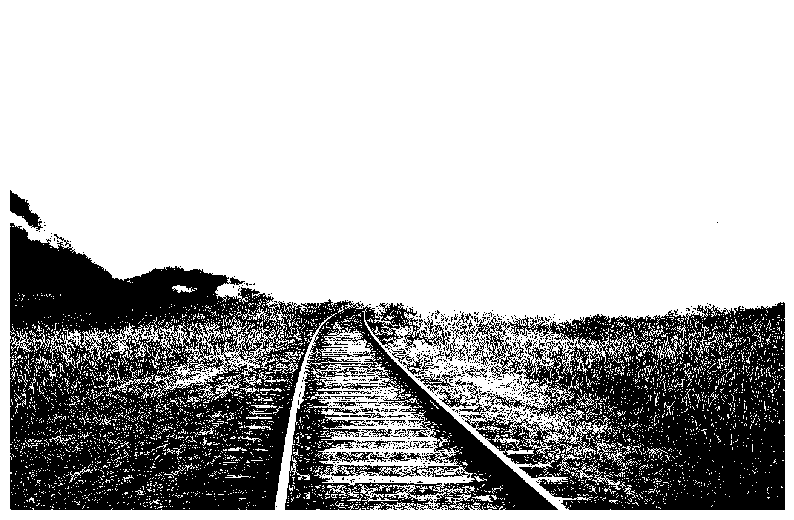

The image dimensions according to (height, width, channels) is: (827, 1280)


In [22]:
binary_img = binary(image4, 0.3)
display(binary_img)
print_stats(binary_img)

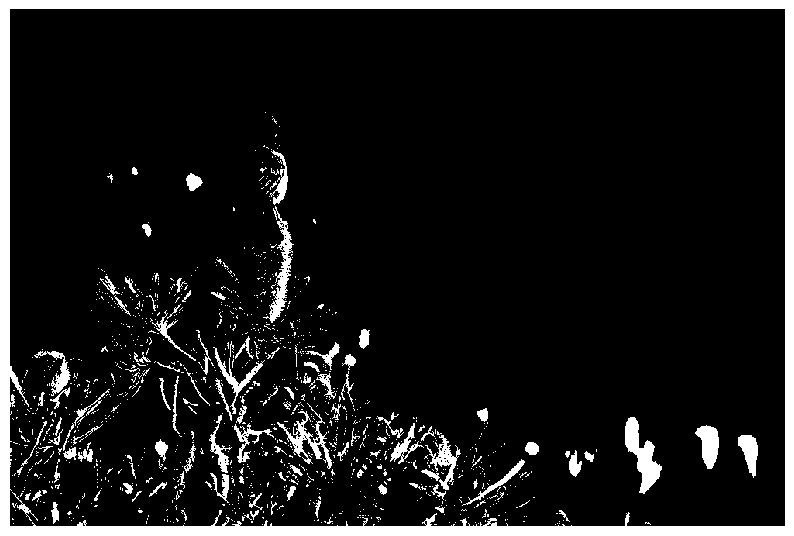

The image dimensions according to (height, width, channels) is: (667, 1000)


In [23]:
binary_img = binary(grey_img, 0.7)
display(binary_img)
print_stats(binary_img)

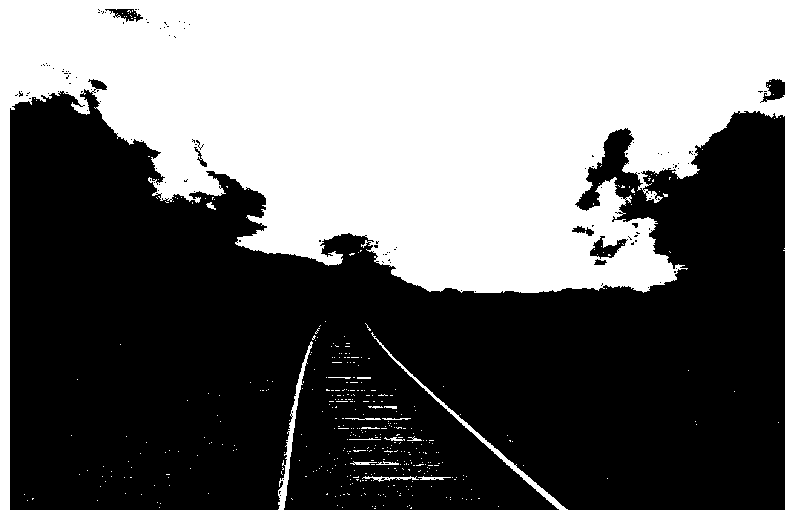

The image dimensions according to (height, width, channels) is: (827, 1280)


In [24]:
# Add your own tests here...
binary_img = binary(image4, 0.7)
display(binary_img)
print_stats(binary_img)

## Question 3: Convolution (25%)

### 3.1 2D convolution

Using the definition of 2D convolution from week 1, implement the convolution operation in the function `conv2D()` in a1code.py.


In [25]:
test_conv2D()

### 3.2 RGB convolution

In the function `conv` in a1code.py, extend your function `conv2D` to work on RGB images, by applying the 2D convolution to each channel independently. 

### 3.3 Gaussian filter convolution

Use the `gauss2D` function provided in a1code.py to create a Gaussian kernel, and apply it to your images with convolution. You will obtain marks for trying different tests and analysing the results, for example:

- try varying the image size, and the size and variance of the filter  
- subtract the filtered image from the original - this gives you an idea of what information is lost when filtering

What do you observe and why?

### 3.4 Sobel filters

Define a horizontal and vertical Sobel edge filter kernel and test them on your images. You will obtain marks for testing them and displaying results in interesting ways, for example:

- apply them to an image at different scales
- considering how to display positive and negative gradients
- apply different combinations of horizontal and vertical filters

## Gaussian Filters

In [26]:
# Your code to answer 3.3, 3.4 and displaay results here.
horz_sobel = np.array([[1,0,-1],[2,0,-2],[1,0,-1]])
vert_sobel = np.array([[1,2,1],[0,0,0],[-1,-2,-1]])
# Gauss filter/kernel creation
gauss_kernel_1 = gauss2D(3, 1.0)
gauss_kernel_2 = gauss2D(9, 2.5)

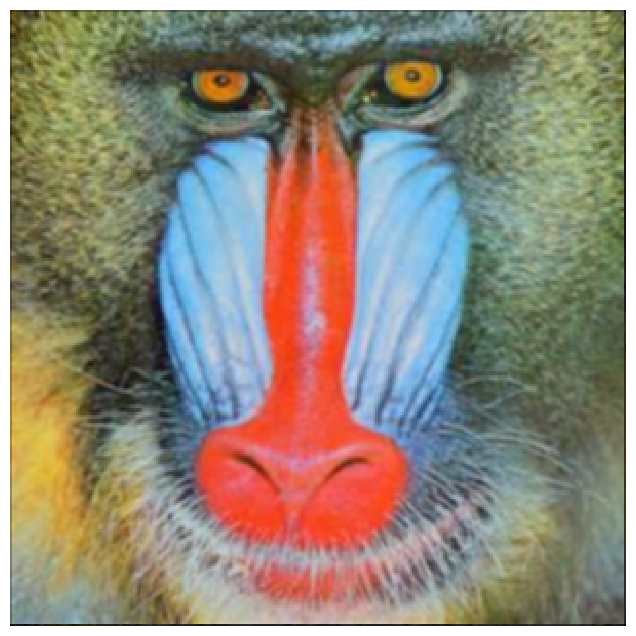

The image dimensions according to (height, width, channels) is: (300, 300, 3)


In [27]:
# applying gaussian filter 3x3 to mandrill image
mandrill_gaussian_3 = conv(image2, gauss_kernel_1)
display(mandrill_gaussian_3)
print_stats(mandrill_gaussian_3)

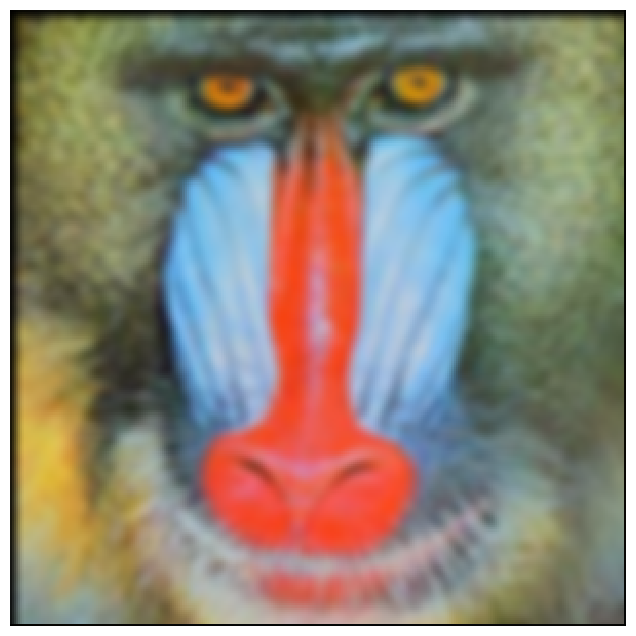

The image dimensions according to (height, width, channels) is: (300, 300, 3)


In [28]:
mandrill_gaussian_5 = conv(image2, gauss_kernel_2)
display(mandrill_gaussian_5)
print_stats(mandrill_gaussian_5)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 299.5, 299.5, -0.5)

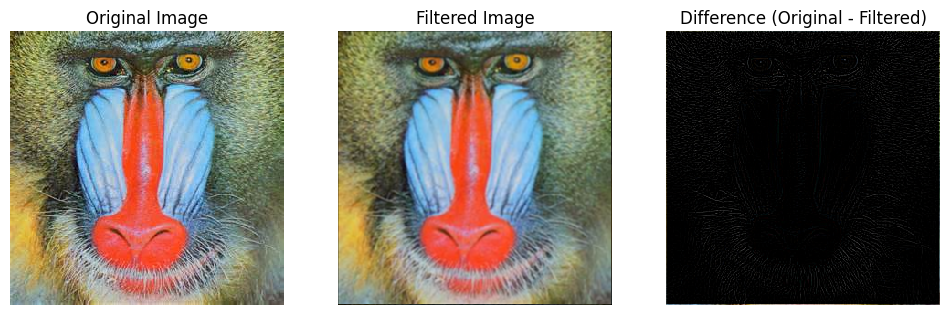

In [29]:
difference_image = image2 - mandrill_gaussian_3
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image2, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(mandrill_gaussian_3, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 299.5, 299.5, -0.5)

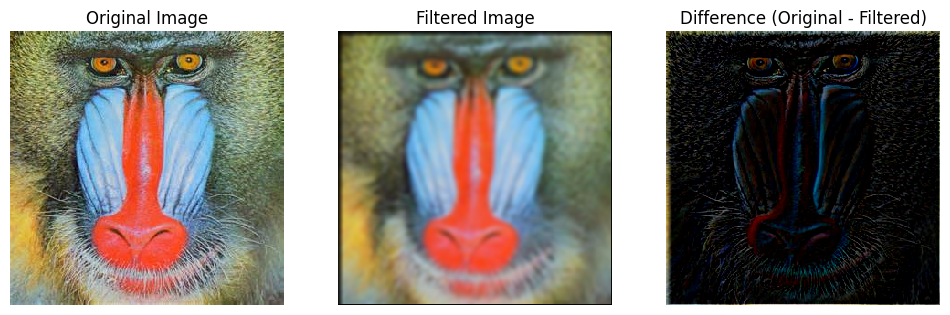

In [30]:
# difference with gaussian kernel 2
difference_image2 = image2 - mandrill_gaussian_5
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image2, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(mandrill_gaussian_5, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image2, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

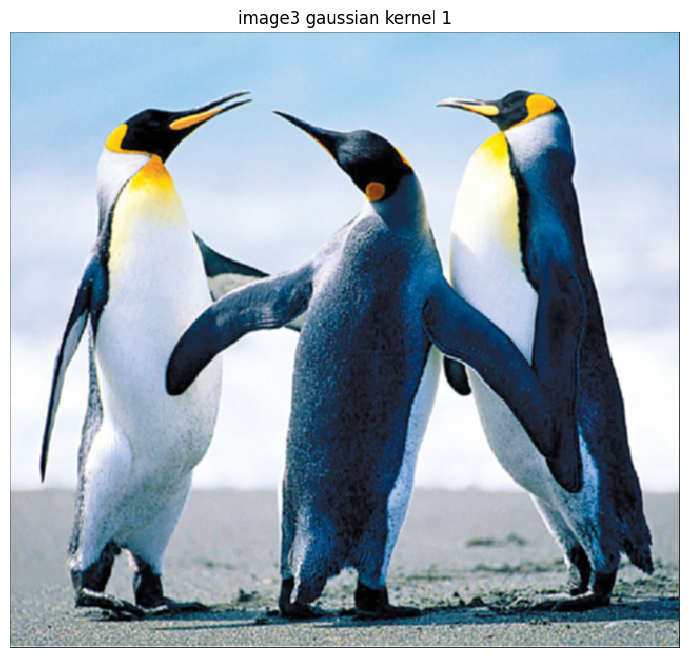

The image dimensions according to (height, width, channels) is: (585, 636, 3)


In [31]:

image3_gaussian_1 = conv(image3, gauss_kernel_1)
display(image3_gaussian_1, 'image3 gaussian kernel 1')
print_stats(image3_gaussian_1)

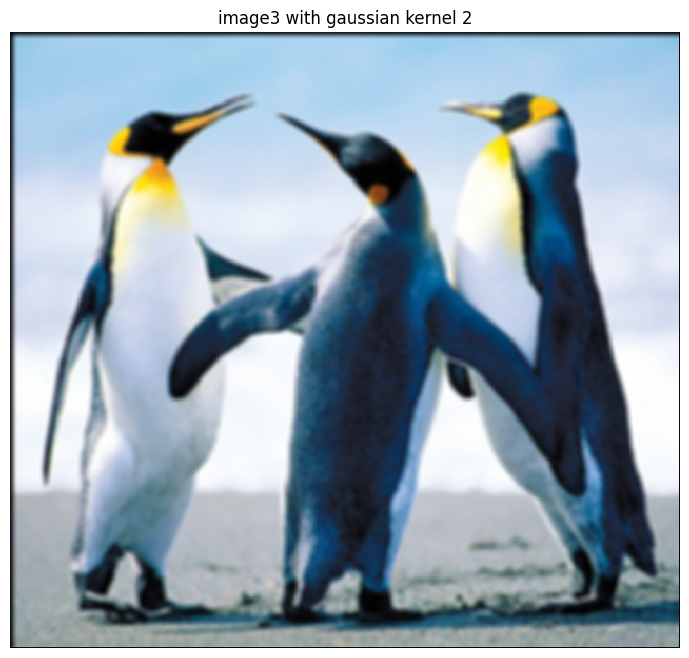

The image dimensions according to (height, width, channels) is: (585, 636, 3)


In [32]:
image3_gaussian_2 = conv(image3, gauss_kernel_2)
display(image3_gaussian_2, 'image3 with gaussian kernel 2')
print_stats(image3_gaussian_2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 635.5, 584.5, -0.5)

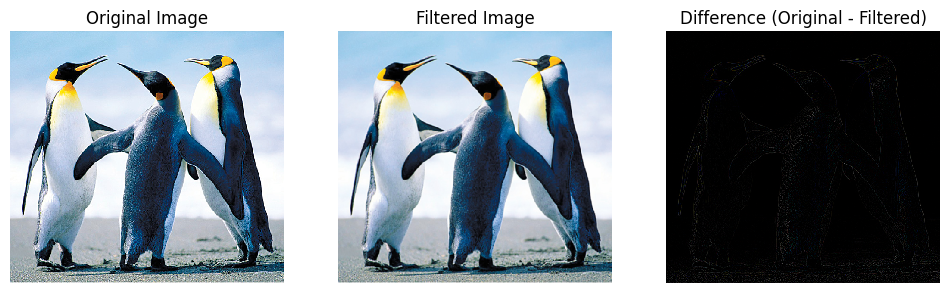

In [33]:
difference_image = image3 - image3_gaussian_1
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image3, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image3_gaussian_1, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 635.5, 584.5, -0.5)

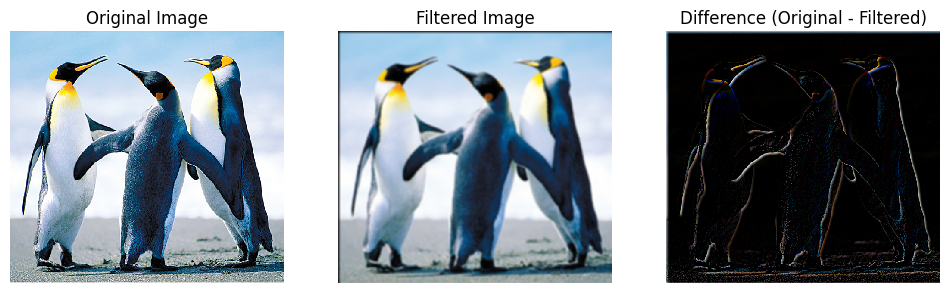

In [34]:
difference_image2 = image3 - image3_gaussian_2
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image3, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image3_gaussian_2, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image2, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

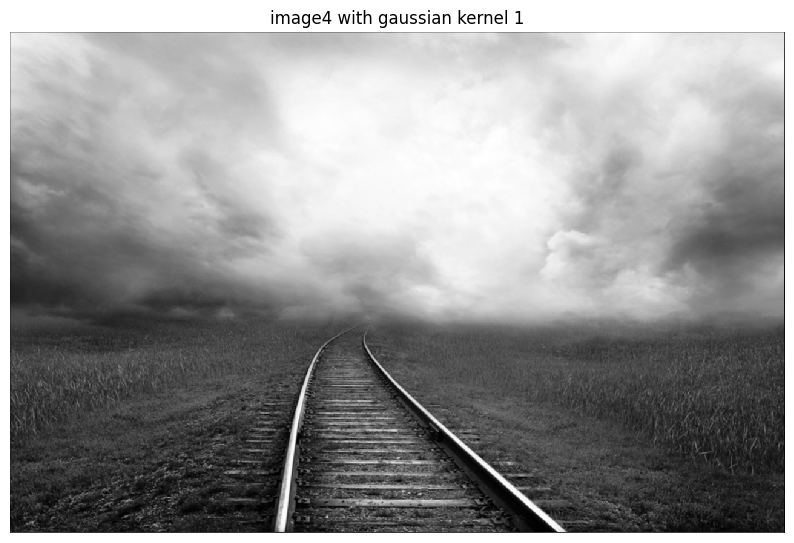

The image dimensions according to (height, width, channels) is: (827, 1280)


In [35]:
# applying gaussian filter 3x3 to greyscale scenery image
image4_gaussian_1 = conv(image4, gauss_kernel_1)
display(image4_gaussian_1, 'image4 with gaussian kernel 1')
print_stats(image4_gaussian_1)

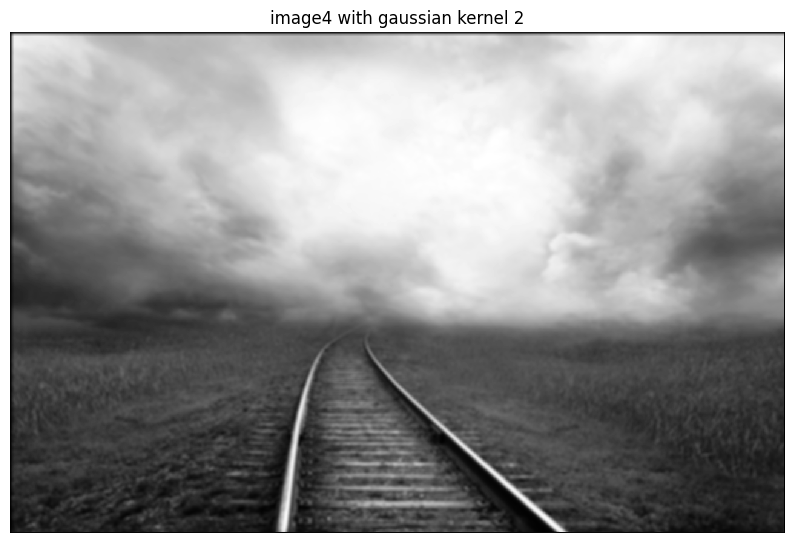

The image dimensions according to (height, width, channels) is: (827, 1280)


In [36]:
# applying gaussian filter 5x5 to greyscale scenery image
image4_gaussian_2 = conv(image4, gauss_kernel_2)
display(image4_gaussian_2, 'image4 with gaussian kernel 2')
print_stats(image4_gaussian_2)

(-0.5, 1279.5, 826.5, -0.5)

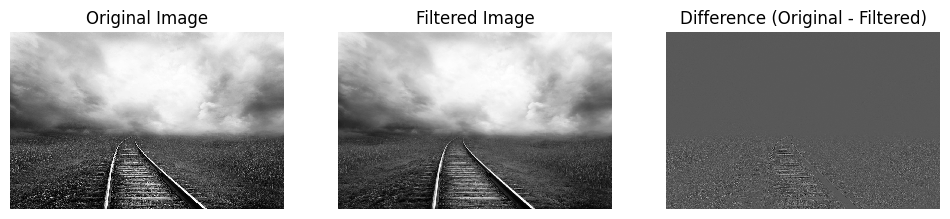

In [37]:
difference_image = image4 - image4_gaussian_1
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image4, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image4_gaussian_1, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

(-0.5, 1279.5, 826.5, -0.5)

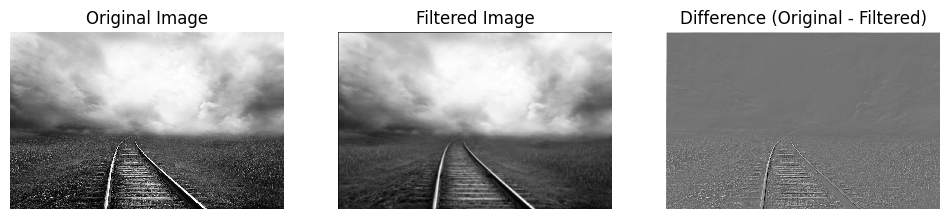

In [38]:
difference_image2 = image4 - image4_gaussian_2
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image4, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image4_gaussian_2, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image2, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

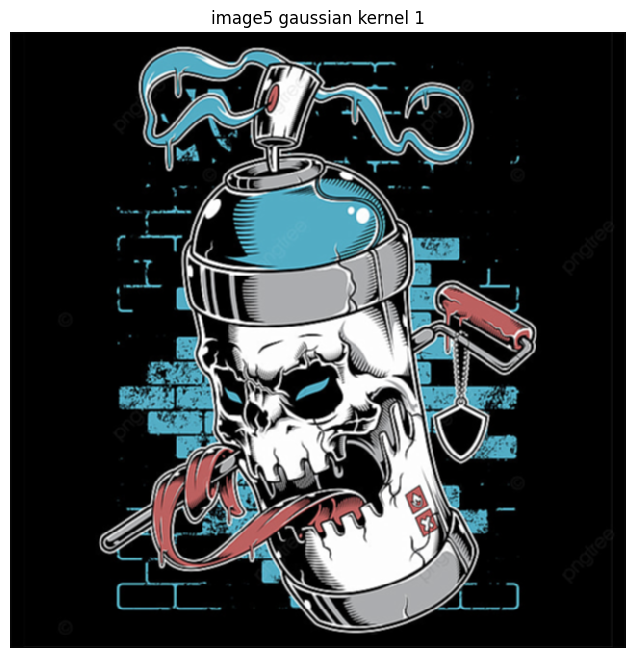

The image dimensions according to (height, width, channels) is: (640, 640, 3)


In [39]:
image5_gaussian_1 = conv(image5, gauss_kernel_1)
display(image5_gaussian_1, 'image5 gaussian kernel 1')
print_stats(image5_gaussian_1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 639.5, -0.5)

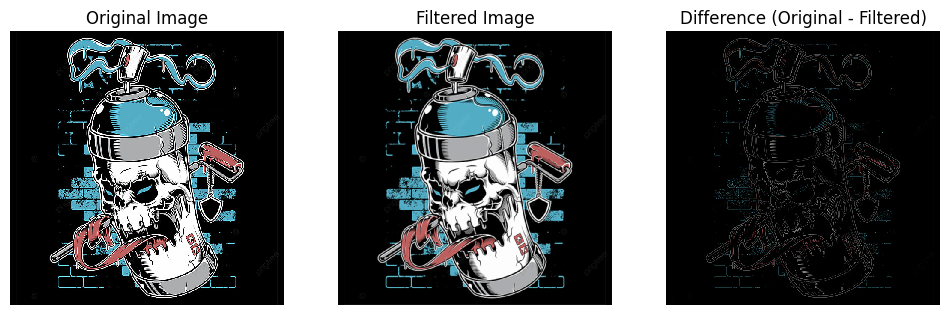

In [40]:
difference_image = image5 - image5_gaussian_1
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image5, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image5_gaussian_1, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

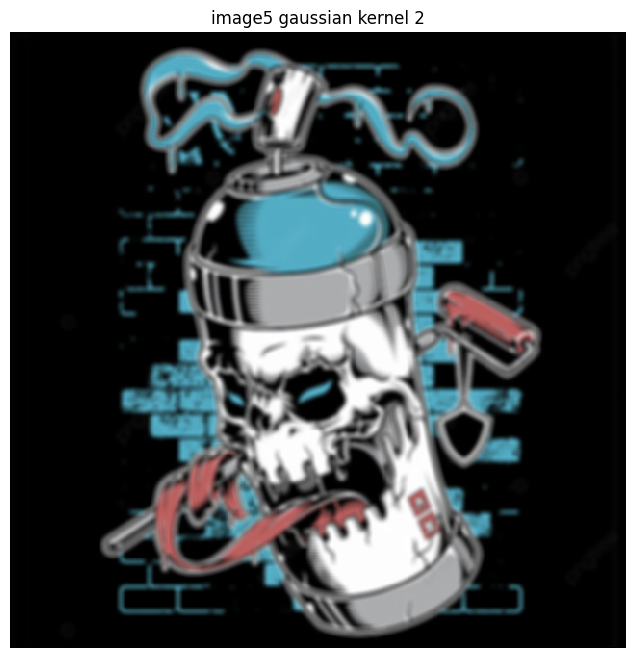

The image dimensions according to (height, width, channels) is: (640, 640, 3)


In [41]:
image5_gaussian_2 = conv(image5, gauss_kernel_2)
display(image5_gaussian_2, 'image5 gaussian kernel 2')
print_stats(image5_gaussian_2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 639.5, -0.5)

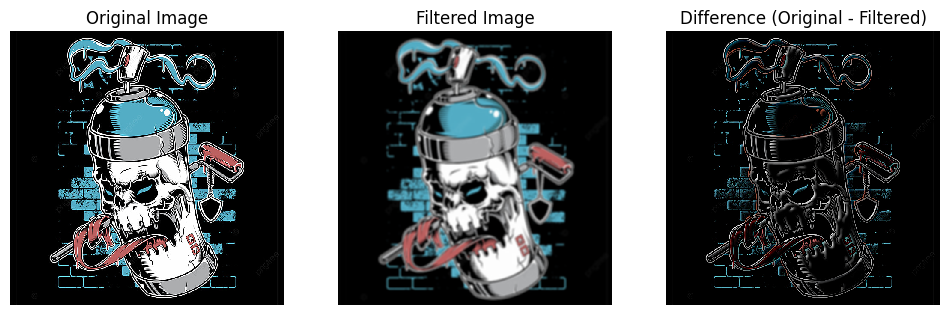

In [42]:
difference_image2 = image5 - image5_gaussian_2
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image5, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image5_gaussian_2, cmap='gray')
axes[1].set_title('Filtered Image')
axes[1].axis('off')
axes[2].imshow(difference_image2, cmap='gray')
axes[2].set_title('Difference (Original - Filtered)')
axes[2].axis('off')

### Observations on Gaussian Filter
By observing and analyzing the difference image, we can gain insights into the effects of the Gaussian filter. The difference image highlights the parts of the original image that were altered by the filter. In areas where the filter smoothed or blurred the image, the difference will be more pronounced. We can see the difference in the comparison of the images shown

## Sobel Filter

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


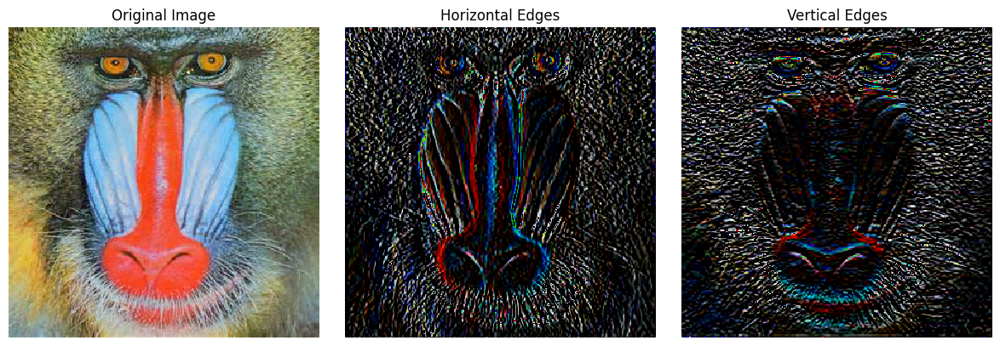

In [43]:
# applying horz sobel filter
mandrill_horz_sobel_output = conv(image2, horz_sobel)
mandrill_vert_sobel_output = conv(image2, vert_sobel)
# display(mandrill_horz_sobel_output, 'mandrill with horizontal sobel')
# print_stats(mandrill_horz_sobel_output)
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image2, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(mandrill_horz_sobel_output, cmap='gray')
axes[1].set_title('Horizontal Edges')
axes[1].axis('off')
axes[2].imshow(mandrill_vert_sobel_output, cmap='gray')
axes[2].set_title('Vertical Edges')
axes[2].axis('off')
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


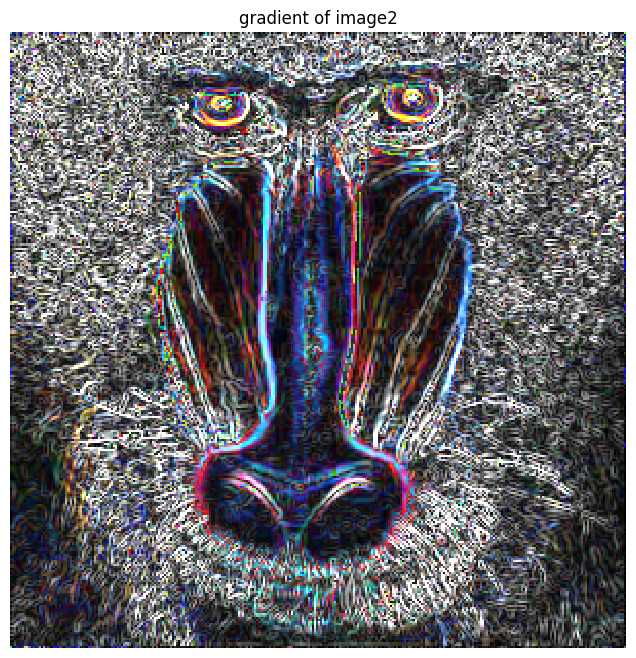

In [56]:
image2_gradient = np.sqrt(mandrill_horz_sobel_output**2 + mandrill_vert_sobel_output**2)
display(image2_gradient, 'gradient of image2')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


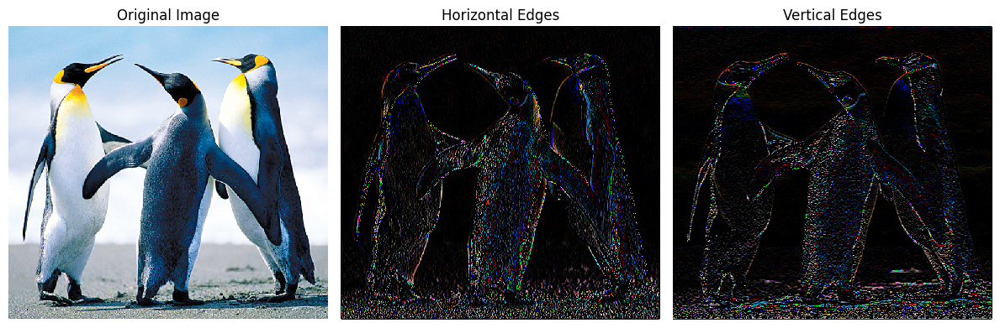

In [44]:
# applying horz sobel filter
image3_horz_sobel_output = conv(image3, horz_sobel)
image3_vert_sobel_output = conv(image3, vert_sobel)
# display(image3_horz_sobel_output, 'image3 with horizontal sobel')
# print_stats(image3_horz_sobel_output)
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image3, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image3_horz_sobel_output, cmap='gray')
axes[1].set_title('Horizontal Edges')
axes[1].axis('off')
axes[2].imshow(image3_vert_sobel_output, cmap='gray')
axes[2].set_title('Vertical Edges')
axes[2].axis('off')
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


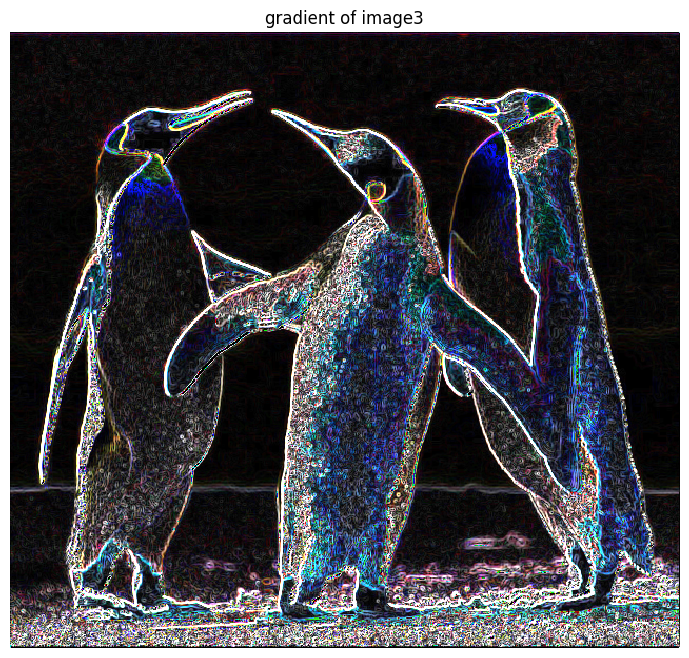

In [58]:
image3_gradient = np.sqrt(image3_horz_sobel_output**2 + image3_vert_sobel_output**2)
display(image3_gradient, 'gradient of image3')

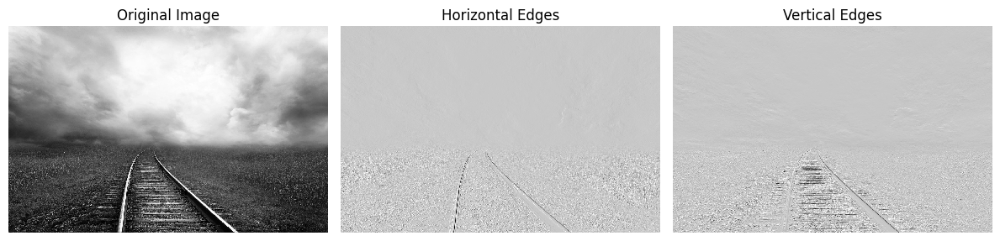

In [45]:
# applying horz sobel filter
image4_horz_sobel_output = conv(image4, horz_sobel)
image4_vert_sobel_output = conv(image4, vert_sobel)
# display(image4_horz_sobel_output, 'image4 with horizontal sobel')
# print_stats(image4_horz_sobel_output)
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image4, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image4_horz_sobel_output, cmap='gray')
axes[1].set_title('Horizontal Edges')
axes[1].axis('off')
axes[2].imshow(image4_vert_sobel_output, cmap='gray')
axes[2].set_title('Vertical Edges')
axes[2].axis('off')
plt.tight_layout()
plt.show()

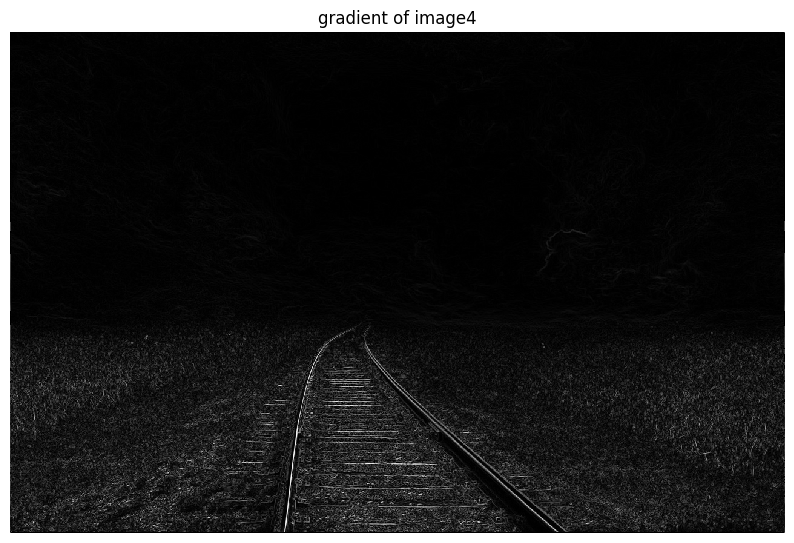

In [59]:
image4_gradient = np.sqrt(image4_horz_sobel_output**2 + image4_vert_sobel_output**2)
display(image4_gradient, 'gradient of image4')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


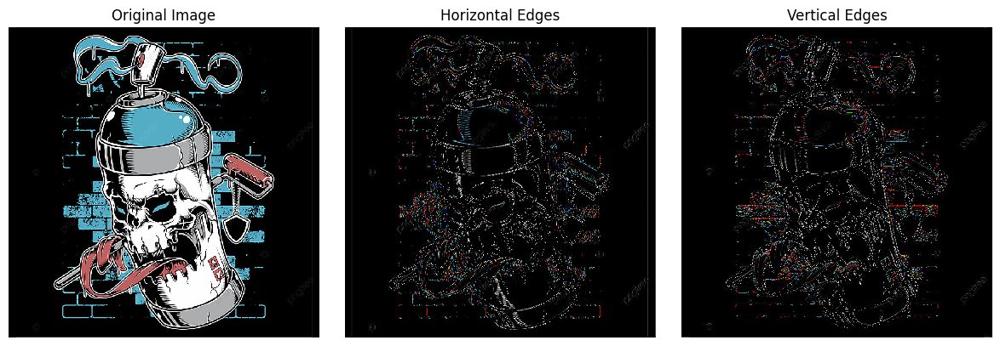

In [46]:
# applying horz sobel filter
image5_horz_sobel_output = conv(image5, horz_sobel)
image5_vert_sobel_output = conv(image5, vert_sobel)
# display(image4_horz_sobel_output, 'image4 with horizontal sobel')
# print_stats(image4_horz_sobel_output)
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(image5, cmap='gray')
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image5_horz_sobel_output, cmap='gray')
axes[1].set_title('Horizontal Edges')
axes[1].axis('off')
axes[2].imshow(image5_vert_sobel_output, cmap='gray')
axes[2].set_title('Vertical Edges')
axes[2].axis('off')
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


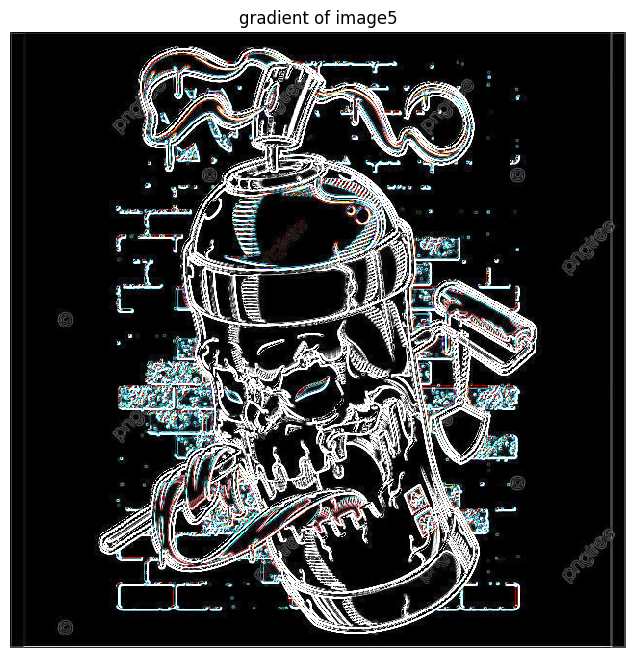

In [60]:
image5_gradient = np.sqrt(image5_horz_sobel_output**2 + image5_vert_sobel_output**2)
display(image5_gradient, 'gradient of image5')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


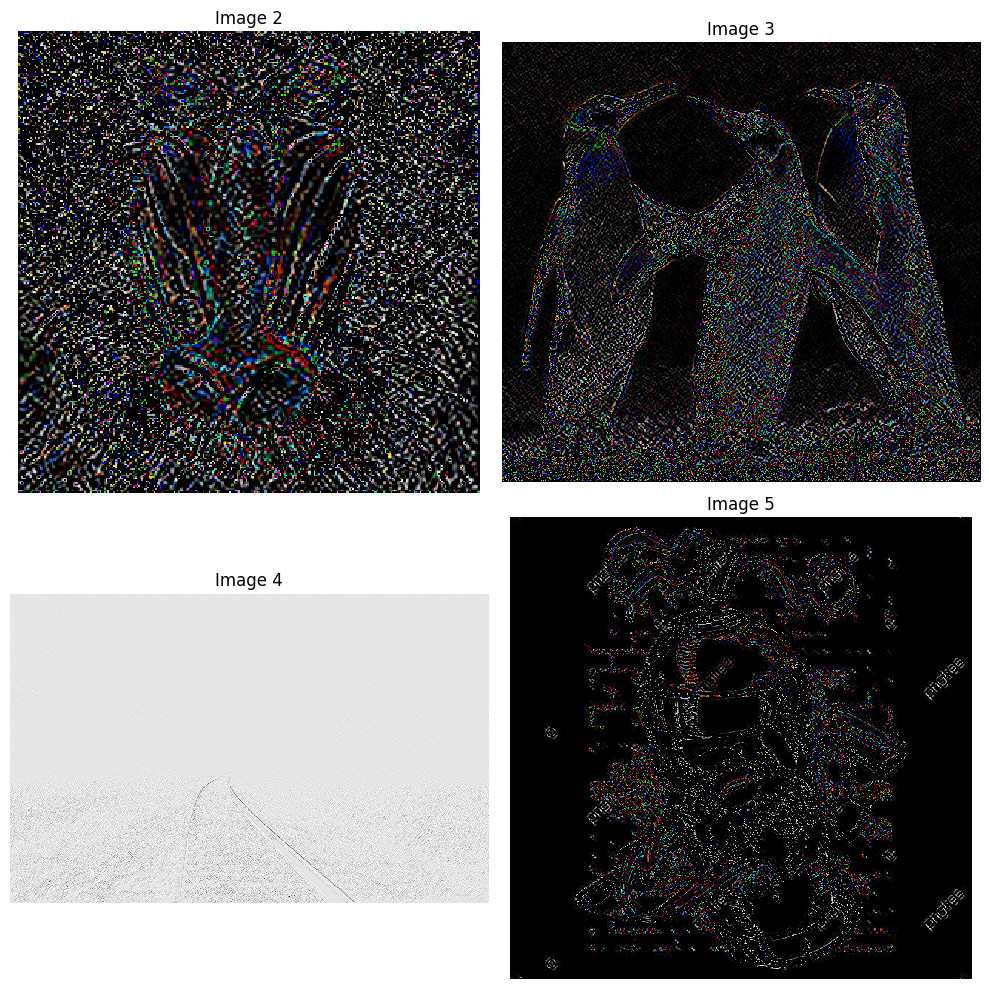

In [61]:
image2_vert_sobel_on_horz_input = conv(mandrill_horz_sobel_output, vert_sobel)
image3_vert_sobel_on_horz_input = conv(image3_horz_sobel_output, vert_sobel)
image4_vert_sobel_on_horz_input = conv(image4_horz_sobel_output, vert_sobel)
image5_vert_sobel_on_horz_input = conv(image5_horz_sobel_output, vert_sobel)
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()
images = [image2_vert_sobel_on_horz_input, image3_vert_sobel_on_horz_input, image4_vert_sobel_on_horz_input, image5_vert_sobel_on_horz_input]
titles = ['Image 2', 'Image 3', 'Image 4', 'Image 5']
for i, ax in enumerate(axes):
    ax.imshow(images[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

***Your comments/analysis of your results here...***

### Observations of Sobel Filter
By displaying the original image, horizontal edges, and vertical edges, we can visualize the edges detected in different orientations. The produced images shows regions of high gradient intensity where edges are present. Positive gradients represent edges with high intensity, whereas negative gradients represent edges with low intensity.

The magnitude of gradients of the images are also shown in the results which shows the areas of significant variation of intensity. Higher magnitude of gradient shows stronger edges and lower magnitude of gradient shows weaker edges.

At the last we have the results of the output of horizontal sobel filter given an input to the vertical sobel filter. By the observation we can detect the darker regions shows stronger horizontal edges and weaker region shows lighter horizontal edges. As seen in the image 3, right track is stronger as compared to left track.

## Question 4: Image sampling and pyramids (35%)

### 4.1 Image Sampling

Apply your `resize()` function to reduce an image (I) to 0.5 height and width

Repeat the above procedure, but apply a Gaussian blur filter to your original image before downsampling it. How does the result compare to your previous output, and to the original image? Why?


### 4.2 Image Pyramids 
Creat a Gaussian pyramid as described in week2's lecture on an image.

Apply a Gaussian kernel to an image I, and resize it with ratio 0.5, to get $I_1$. Repeat this step to get $I_2$, $I_3$ and $I_4$.

Display these four images in a manner analogus to the example shown in the lectures.




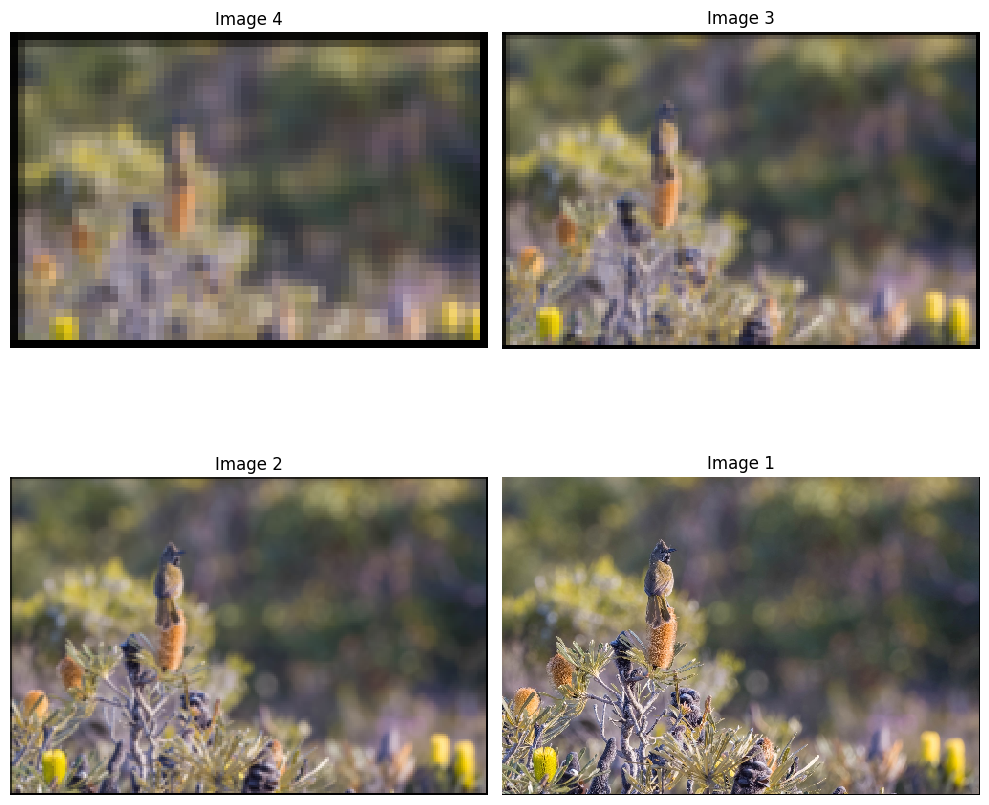

In [47]:
# Your answers to question 4 here
I = image1
gauss_kernel_3 = gauss2D(5,1.0)
I1 = conv(I, gauss_kernel_3)
I1 = resize(I, int(0.5*I.shape[0]), int(0.5*I.shape[1]))
I2 = conv(I1, gauss_kernel_3)
I2 = resize(I2, int(0.5*I1.shape[0]), int(0.5*I1.shape[1]))
I3 = conv(I2, gauss_kernel_3)
I3 = resize(I3, int(0.5*I2.shape[0]), int(0.5*I2.shape[1]))
I4 = conv(I3, gauss_kernel_3)
I4 = resize(I4, int(0.5*I3.shape[0]), int(0.5*I3.shape[1]))
pyramid = [I4,I3,I2,I1,I]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

titles = ['Image 4', 'Image 3', 'Image 2', 'Image 1', 'Image']
for i, ax in enumerate(axes):
    ax.imshow(pyramid[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

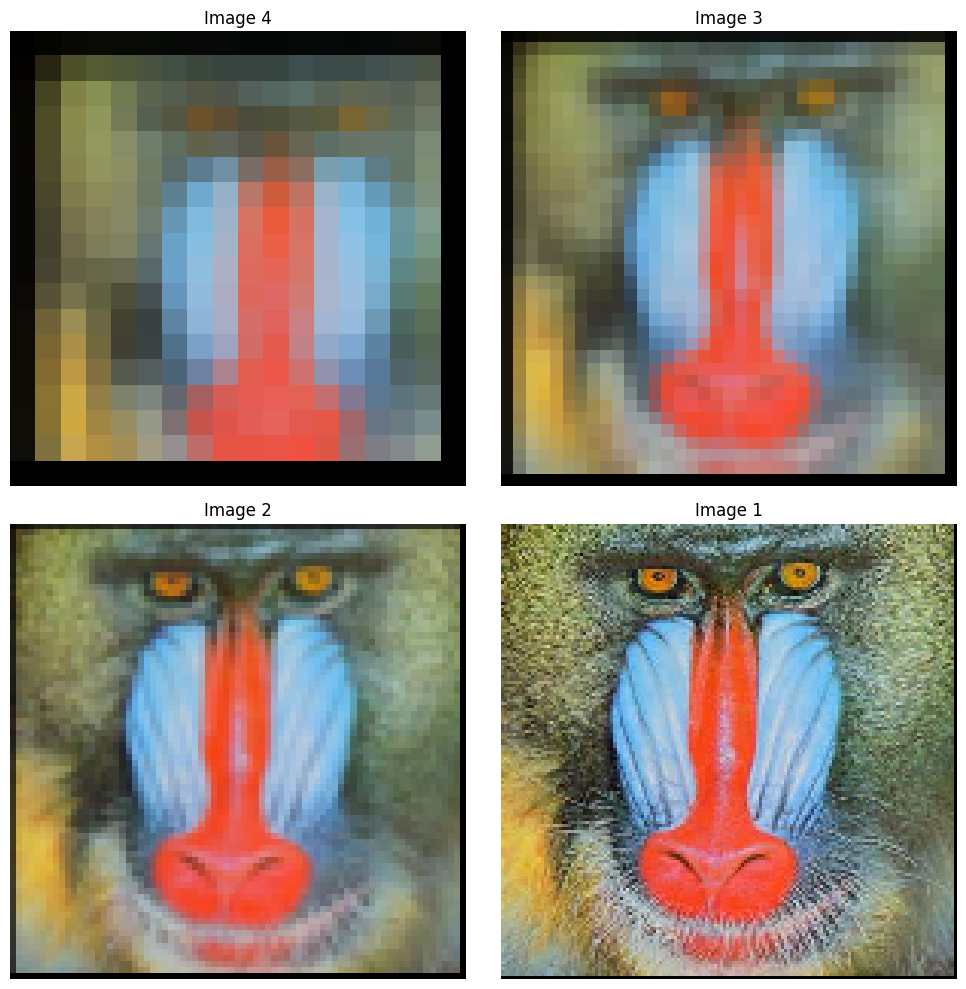

In [48]:
# Your answers to question 4 here
I = image2
gauss_kernel_3 = gauss2D(5,1.0)
I1 = conv(I, gauss_kernel_3)
I1 = resize(I, int(0.5*I.shape[0]), int(0.5*I.shape[1]))
I2 = conv(I1, gauss_kernel_3)
I2 = resize(I2, int(0.5*I1.shape[0]), int(0.5*I1.shape[1]))
I3 = conv(I2, gauss_kernel_3)
I3 = resize(I3, int(0.5*I2.shape[0]), int(0.5*I2.shape[1]))
I4 = conv(I3, gauss_kernel_3)
I4 = resize(I4, int(0.5*I3.shape[0]), int(0.5*I3.shape[1]))
pyramid = [I4,I3,I2,I1,I]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

titles = ['Image 4', 'Image 3', 'Image 2', 'Image 1', 'Image']
for i, ax in enumerate(axes):
    ax.imshow(pyramid[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

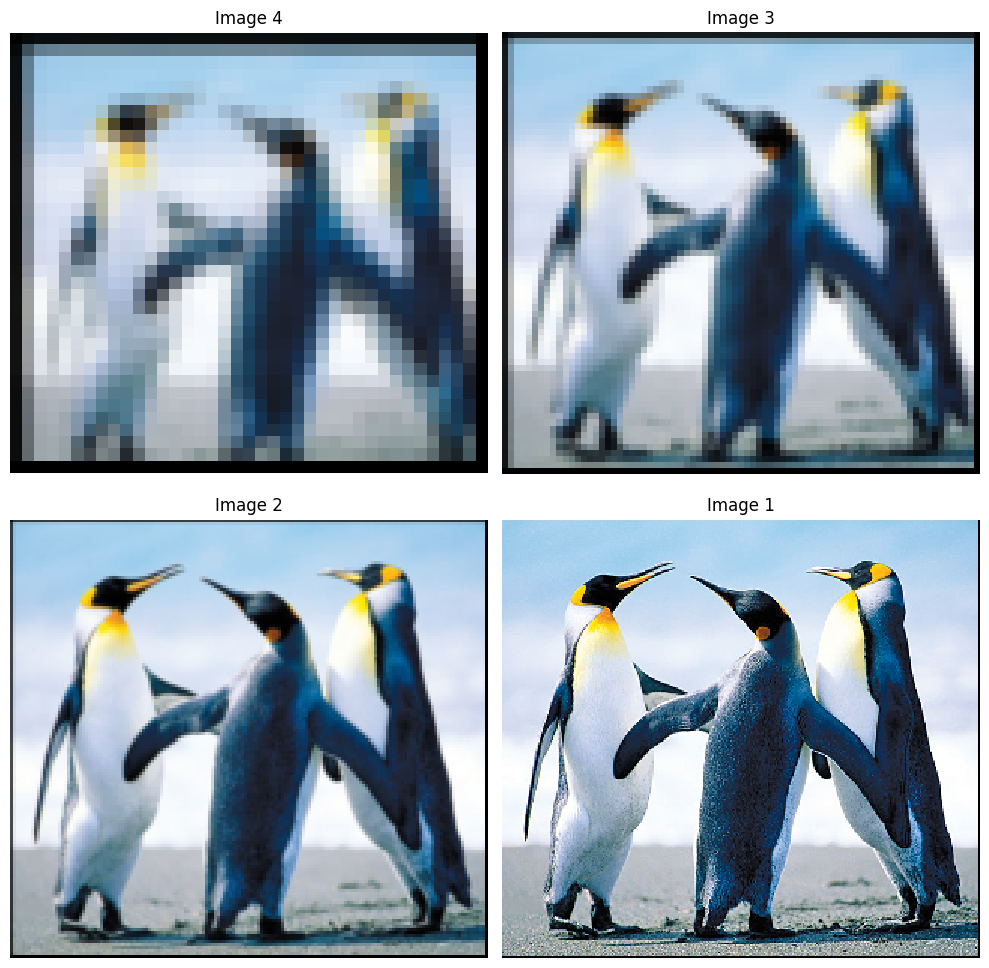

In [49]:
# Your answers to question 4 here
I = image3
gauss_kernel_3 = gauss2D(5,1.0)
I1 = conv(I, gauss_kernel_3)
I1 = resize(I, int(0.5*I.shape[0]), int(0.5*I.shape[1]))
I2 = conv(I1, gauss_kernel_3)
I2 = resize(I2, int(0.5*I1.shape[0]), int(0.5*I1.shape[1]))
I3 = conv(I2, gauss_kernel_3)
I3 = resize(I3, int(0.5*I2.shape[0]), int(0.5*I2.shape[1]))
I4 = conv(I3, gauss_kernel_3)
I4 = resize(I4, int(0.5*I3.shape[0]), int(0.5*I3.shape[1]))
pyramid = [I4,I3,I2,I1,I]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

titles = ['Image 4', 'Image 3', 'Image 2', 'Image 1', 'Image']
for i, ax in enumerate(axes):
    ax.imshow(pyramid[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

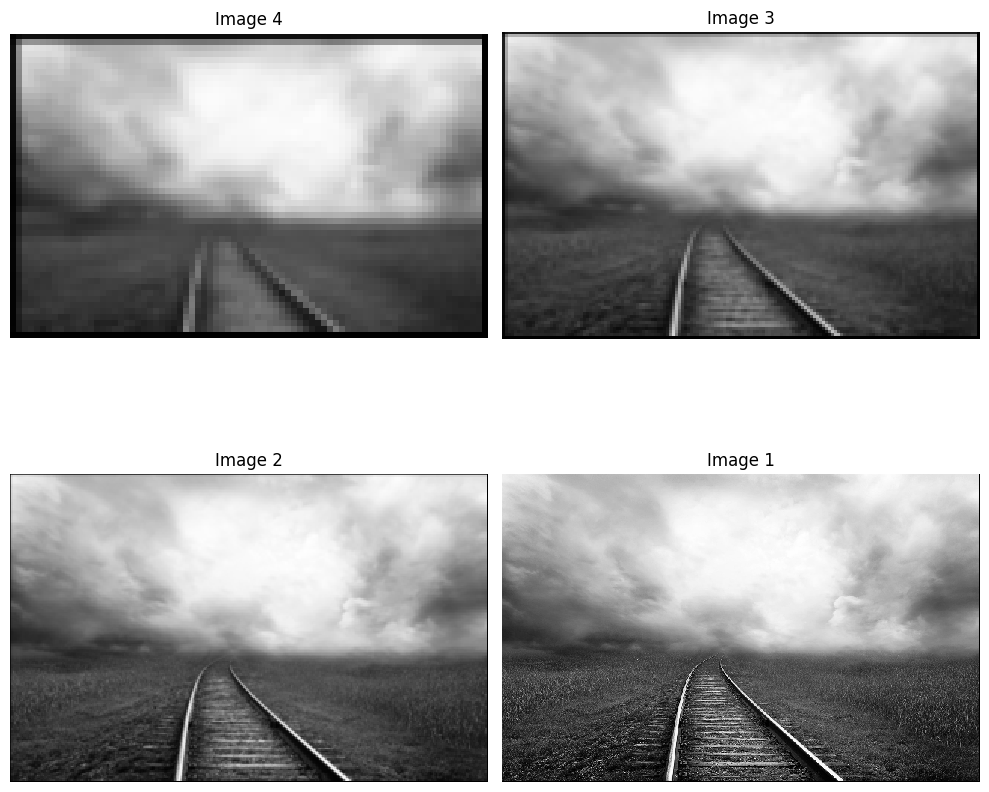

In [50]:
# Your answers to question 4 here
I = image4
gauss_kernel_3 = gauss2D(5,1.0)
I1 = conv(I, gauss_kernel_3)
I1 = resize(I, int(0.5*I.shape[0]), int(0.5*I.shape[1]))
I2 = conv(I1, gauss_kernel_3)
I2 = resize(I2, int(0.5*I1.shape[0]), int(0.5*I1.shape[1]))
I3 = conv(I2, gauss_kernel_3)
I3 = resize(I3, int(0.5*I2.shape[0]), int(0.5*I2.shape[1]))
I4 = conv(I3, gauss_kernel_3)
I4 = resize(I4, int(0.5*I3.shape[0]), int(0.5*I3.shape[1]))
pyramid = [I4,I3,I2,I1,I]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

titles = ['Image 4', 'Image 3', 'Image 2', 'Image 1', 'Image']
for i, ax in enumerate(axes):
    ax.imshow(pyramid[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

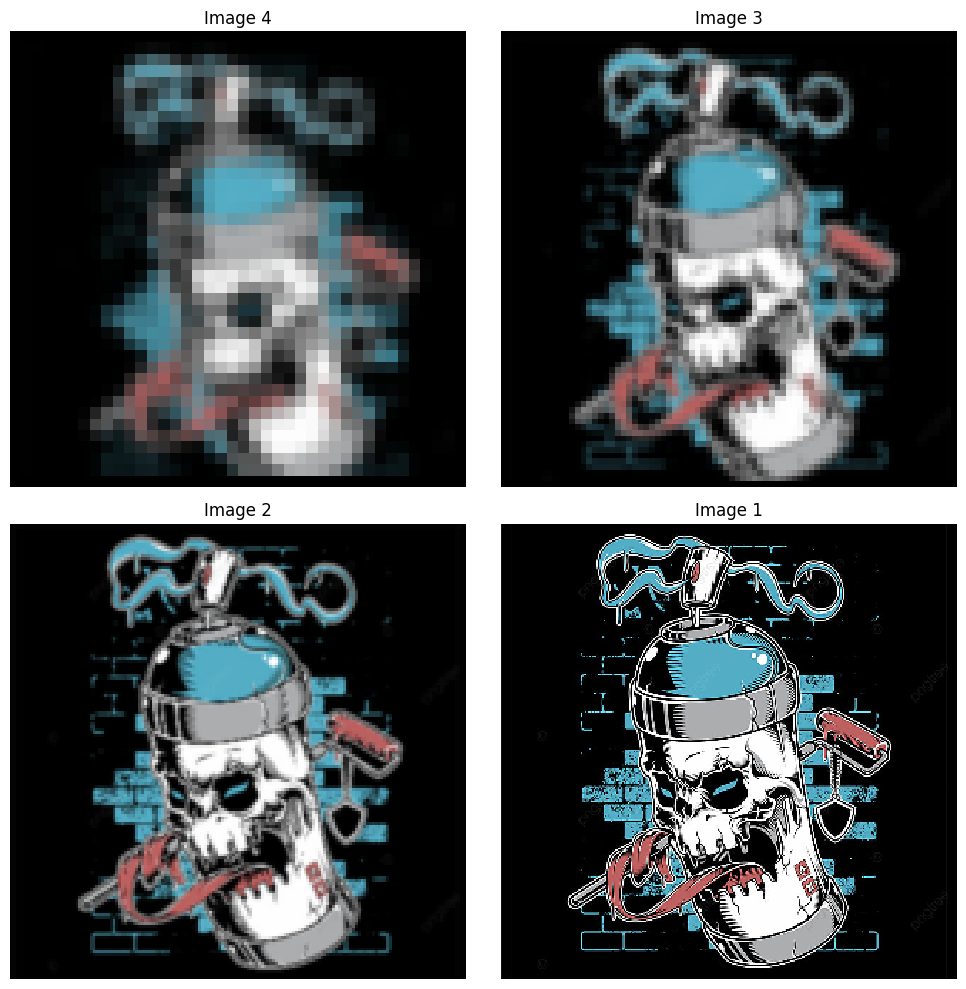

In [51]:
# Your answers to question 4 here
I = image5
gauss_kernel_3 = gauss2D(5,1.0)
I1 = conv(I, gauss_kernel_3)
I1 = resize(I, int(0.5*I.shape[0]), int(0.5*I.shape[1]))
I2 = conv(I1, gauss_kernel_3)
I2 = resize(I2, int(0.5*I1.shape[0]), int(0.5*I1.shape[1]))
I3 = conv(I2, gauss_kernel_3)
I3 = resize(I3, int(0.5*I2.shape[0]), int(0.5*I2.shape[1]))
I4 = conv(I3, gauss_kernel_3)
I4 = resize(I4, int(0.5*I3.shape[0]), int(0.5*I3.shape[1]))
pyramid = [I4,I3,I2,I1,I]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

titles = ['Image 4', 'Image 3', 'Image 2', 'Image 1', 'Image']
for i, ax in enumerate(axes):
    ax.imshow(pyramid[i], cmap='gray')
    ax.set_title(titles[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

***Your comments/analysis of your results here...***
In this code we applied the resize function to resize the convolved images from gaussian filter of (5x5) with sigma of 1.0. 
The gaussian pyramid is created by repeatedly applying gaussian filter and doing downsampling of images.
By comparing the downsampled images with blur to the preceeding images, we can see the smoothening effects of gaussian blur filter in each downsampled images. Also we can see that the details are also reducing in each downsampling.
It shows how the progress of reduction of image resolution and smoothening of images takes place.

## Question 5: Auto correlation (optional, unassessed)

Recall from week 2 that cross-correlation is a measure of similarity between a template and an image. It is defined similarly to convolution.

### 5.1 Correlation function

Implement the function `corr()` in a1code.py, based on your convolution function. Hint: numpy's `flip()` function may be useful here.

### 5.2 Auto-correlation

We will experiment with *auto-correlation*, where the template patch is taken from the image it is being compared to. Use a crop from your image as your template. Calculate the correlation of that template with every location in the image, and display the output as an image. Where is the maximum similarity? (Hint: numpy functions `argmax()` and `unravel()` will be useful here). For simplicity, you can use a greyscale version of the image and template.

Try this on an image with some symmetry, such as a person's face and crop the eye.




In [52]:
# Your code to answer question 5 and display results here